# UMAP-Cluster Pancreas Xenium

https://squidpy.readthedocs.io/en/stable/notebooks/tutorials/tutorial_xenium.html#analyze-xenium-data

In [1]:
%load_ext autoreload
%autoreload 2
%env ANYWIDGET_HMR=1

env: ANYWIDGET_HMR=1


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc
import squidpy as sq
import spatialdata as sd

import celldega as dega

from spatialdata_io import xenium

/Users/feni/anaconda3/envs/celldega_3.9/lib/python3.9/site-packages/numba/core/decorators.py:250: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


In [3]:
from ipywidgets import Widget

In [4]:
ls data

merscope_data/        visium-hd_data/       xenium_landscapes/
merscope_landscapes/  visium-hd_landscapes/
tmp.json              xenium_data/


In [5]:
xenium_path = 'data/xenium_data/Xenium_V1_human_Pancreas_FFPE_outs/'
zarr_path = 'data/xenium_data/Xenium_V1_human_Pancreas_FFPE_outs.zarr'

# Pre-Process, Cluster, and UMAP

In [6]:
sdata = xenium(xenium_path)

INFO     reading data/xenium_data/Xenium_V1_human_Pancreas_FFPE_outs/cell_feature_matrix.h5                        


/var/folders/8d/jxpy9rd10j7fp2rcj_s5sz3c0000gq/T/ipykernel_70631/1221898808.py:1: DeprecationWarning: The default value of `cells_as_circles` will change to `False` in the next release. Please pass `True` explicitly to maintain the current behavior.
  sdata = xenium(xenium_path)


In [8]:
# xenium.write(zarr_path) - original code from documentation
sdata.write(zarr_path)

In [9]:
sdata = sd.read_zarr(zarr_path)
sdata

/Users/feni/anaconda3/envs/celldega_3.9/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


SpatialData object, with associated Zarr store: /Users/feni/Documents/celldega/notebooks/data/xenium_data/Xenium_V1_human_Pancreas_FFPE_outs.zarr
├── Images
│     └── 'morphology_focus': DataTree[cyx] (5, 13770, 34155), (5, 6885, 17077), (5, 3442, 8538), (5, 1721, 4269), (5, 860, 2134)
├── Labels
│     ├── 'cell_labels': DataTree[yx] (13770, 34155), (6885, 17077), (3442, 8538), (1721, 4269), (860, 2134)
│     └── 'nucleus_labels': DataTree[yx] (13770, 34155), (6885, 17077), (3442, 8538), (1721, 4269), (860, 2134)
├── Points
│     └── 'transcripts': DataFrame with shape: (<Delayed>, 11) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (140702, 1) (2D shapes)
│     ├── 'cell_circles': GeoDataFrame shape: (140702, 2) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (136531, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (140702, 377)
with coordinate systems:
    ▸ 'global', with elements:
        morphology_focus (Images), cell_labels (Labels), 

In [10]:
adata = sdata.tables["table"]
adata

AnnData object with n_obs × n_vars = 140702 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count', 'cell_labels'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [11]:
adata.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,z_level,nucleus_count,cell_labels
0,aaaadnje-1,37,0,0,0,0,37,44.117658,38.021564,cell_circles,0.0,1.0,1
1,aaacalai-1,60,0,0,0,0,60,66.244221,33.912345,cell_circles,0.0,1.0,2
2,aaacjgil-1,63,0,0,0,0,63,104.491566,52.697346,cell_circles,0.0,1.0,3
3,aaacpcil-1,12,0,0,0,0,12,34.183282,17.520626,cell_circles,0.0,1.0,4
4,aaadhocp-1,143,0,0,0,0,143,149.060787,51.116877,cell_circles,0.0,1.0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...
140697,oiloppgp-1,14,0,0,0,0,14,15.082188,15.082188,cell_circles,6.0,1.0,140698
140698,oilpccne-1,2,0,0,0,0,2,5.734844,5.734844,cell_circles,6.0,1.0,140699
140699,oimacfoj-1,11,0,0,0,0,11,13.682344,13.682344,cell_circles,6.0,1.0,140700
140700,oimaiaae-1,18,0,0,0,0,18,17.701251,17.701251,cell_circles,6.0,1.0,140701


In [12]:
adata.obsm["spatial"]

array([[ 446.32669067, 1701.3572998 ],
       [ 441.30783081, 1735.87792969],
       [ 466.05319214, 1712.25976562],
       ...,
       [6080.99121094,  626.74212646],
       [6030.59472656,  536.50341797],
       [6022.63720703,  573.78430176]])

### Calculate QC Metrics

In [13]:
sc.pp.calculate_qc_metrics(adata, percent_top=(10, 20, 50, 150), inplace=True)

In [14]:
cprobes = (
    adata.obs["control_probe_counts"].sum() / adata.obs["total_counts"].sum() * 100
)
cwords = (
    adata.obs["control_codeword_counts"].sum() / adata.obs["total_counts"].sum() * 100
)
print(f"Negative DNA probe count % : {cprobes}")
print(f"Negative decoding count % : {cwords}")

Negative DNA probe count % : 0.006005935170375317
Negative decoding count % : 0.0014334407204219034


<Axes: title={'center': 'Nucleus ratio'}, ylabel='Count'>

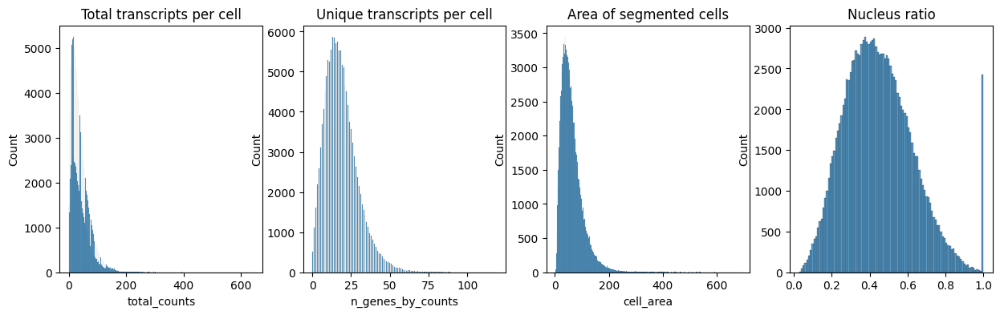

In [15]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))

axs[0].set_title("Total transcripts per cell")
sns.histplot(
    adata.obs["total_counts"],
    kde=False,
    ax=axs[0],
)

axs[1].set_title("Unique transcripts per cell")
sns.histplot(
    adata.obs["n_genes_by_counts"],
    kde=False,
    ax=axs[1],
)


axs[2].set_title("Area of segmented cells")
sns.histplot(
    adata.obs["cell_area"],
    kde=False,
    ax=axs[2],
)

axs[3].set_title("Nucleus ratio")
sns.histplot(
    adata.obs["nucleus_area"] / adata.obs["cell_area"],
    kde=False,
    ax=axs[3],
)

In [16]:
sc.pp.filter_cells(adata, min_counts=10)
sc.pp.filter_genes(adata, min_cells=5)

In [17]:
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata)

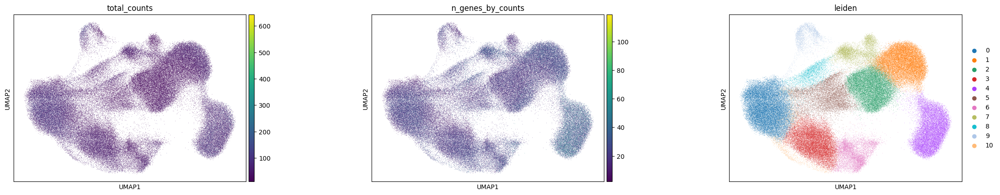

In [18]:
sc.pl.umap(
    adata,
    color=[
        "total_counts",
        "n_genes_by_counts",
        "leiden",
    ],
    wspace=0.4,
)

/Users/feni/anaconda3/envs/celldega_3.9/lib/python3.9/site-packages/squidpy/pl/_spatial_utils.py:946: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


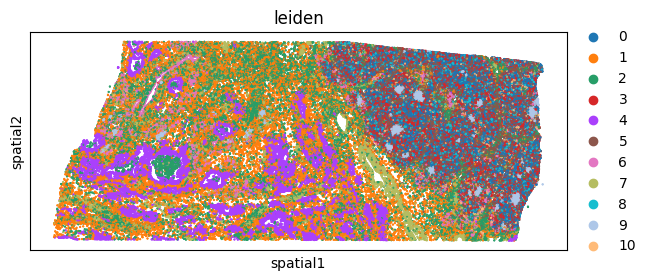

In [19]:
sq.pl.spatial_scatter(
    adata,
    library_id="spatial",
    shape=None,
    color=[
        "leiden",
    ],
    wspace=0.4,
)

In [20]:
adata

AnnData object with n_obs × n_vars = 122678 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count', 'cell_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatialdata_attrs', 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [21]:
adata.obsm['X_umap']

array([[10.506712  ,  1.2212458 ],
       [10.697917  ,  0.6223265 ],
       [11.325302  ,  2.8573225 ],
       ...,
       [ 0.02741709,  5.6208534 ],
       [-0.29021668,  6.7356443 ],
       [-0.5836044 ,  4.175001  ]], dtype=float32)

In [22]:
adata.write_h5ad('data/xenium_data/Xenium_V1_human_Pancreas_FFPE_outs.h5ad')

# Load Pre-calc Clustering and UMAP Results

In [23]:
adata = sc.read_h5ad('data/xenium_data/Xenium_V1_human_Pancreas_FFPE_outs.h5ad')
adata.obs.set_index('cell_id', inplace=True)
adata

AnnData object with n_obs × n_vars = 122678 × 377
    obs: 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count', 'cell_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [24]:
meta_cell = adata.obs['leiden'].to_dict()

In [25]:
clusters = adata.obs['leiden'].cat.categories.tolist()
colors = adata.uns['leiden_colors']
ser_counts = adata.obs['leiden'].value_counts()
ser_color = pd.Series(colors, index=clusters, name='color')
meta_cluster_df = pd.DataFrame(ser_color)
meta_cluster_df['count'] = ser_counts

# meta_cluster.index = ['leiden-' + str(x) for x in meta_cluster.index]
meta_cluster_df.index = [str(x) for x in meta_cluster_df.index]
meta_cluster = meta_cluster_df.to_dict(orient='index')

In [27]:
# umap_df.isna().any().any()

In [28]:
adata.obs.shape

(122678, 21)

In [29]:
# umap_df = pd.DataFrame(adata.obsm['X_umap'] * 500, index=adata.obs.index)
umap_df = pd.DataFrame(adata.obsm['X_umap'], index=adata.obs.index)

# Convert the DataFrame to a dictionary with index as keys and rows as arrays
umap_dict = umap_df.to_dict(orient='index')

# Convert each row dictionary into a list of rounded values
umap = {key: [val for val in value.values()] for key, value in umap_dict.items()}


In [30]:
base_url = 'https://raw.githubusercontent.com/broadinstitute/celldega_Xenium_human_Pancreas_FFPE/main/Landscape_Xenium_V1_human_Pancreas_FFPE_outs_webp'

In [31]:

# landscape_ist

In [32]:
# import pandas as pd
# import numpy as np

# Assuming `adata` is your AnnData object
# Extract cluster assignments from the `leiden` column
adata.obs['leiden'] = adata.obs['leiden'].astype('string')  # Ensure string dtype for clusters

list_ser = []
for inst_cat in adata.obs['leiden'].unique():
    if inst_cat is not None:
        # Get the indices of cells belonging to the current cluster
        inst_cells = adata.obs[adata.obs['leiden'] == inst_cat].index.tolist()

        # Compute the mean expression for the cluster
        inst_ser = pd.Series(adata[inst_cells].X.mean(axis=0).A1, index=adata.var_names)
        inst_ser.name = inst_cat

        list_ser.append(inst_ser)

# Combine results into a single DataFrame
df_sig = pd.concat(list_ser, axis=1)

# Rename columns to cluster names
df_sig.columns = df_sig.columns.tolist()

# Filter genes based on conditions
keep_genes = df_sig.index.tolist()
keep_genes = [x for x in keep_genes if 'Unassigned' not in x]
keep_genes = [x for x in keep_genes if 'NegControl' not in x]
keep_genes = [x for x in keep_genes if 'DeprecatedCodeword' not in x]

df_sig = df_sig.loc[keep_genes]

# # Save the result as a Parquet file
# df_sig.to_parquet('df_sig.parquet')


In [33]:
df_sig.shape

(377, 11)

In [34]:
network = dega.clust.hc(df_sig)

In [37]:
Widget.close_all()
mat = dega.viz.Matrix(network=network, width=500, height=500)
landscape_ist = dega.viz.Landscape(
    technology='Xenium', 
    height=600,
    base_url = base_url,
    meta_cell = meta_cell,
    meta_cluster = meta_cluster,
    umap=umap,
    landscape_state='umap'
)

In [39]:
dega.viz.landscape_matrix(landscape_ist, mat)